In [7]:
%load_ext autoreload
%autoreload 2


In [4]:
from toolkit.opto import defineOptoPopulationTTest
from myphdlib.interface.nope import NOPESession
import numpy as np
from toolkit.opto import defineOptoPopulation
from toolkit.process import AnalysisObject
from myphdlib.interface.factory import SessionFactory
import os
import felsen_analysis.toolkit.saccades as fs
import felsen_analysis.toolkit.opto as op
import felsen_analysis.toolkit.populations as pop
import felsen_analysis.toolkit.plots as pl

In [1]:
fileList = [
           '/media/jbhunt/Seagate Portable Drive/2023-07-24/mlati9',
             '/media/jbhunt/Seagate Portable Drive/2023-07-25/mlati10',
             '/media/jbhunt/Seagate Portable Drive/2023-07-26/mlati9',
             '/media/jbhunt/Seagate Portable Drive/2023-07-27/mlati10',
             '/media/jbhunt/Seagate Portable Drive/2023-07-28/mlati9',
             '/media/jbhunt/Seagate Portable Drive/2023-07-31/mlati10',
             '/media/jbhunt/Seagate Portable Drive/2023-08-01/mlati10']

In [3]:
h5file = '/media/jbhunt/EPHYS-01/7-24-25/squarewave/output.hdf'
basePath = '/media/jbhunt/EPHYS-01/2025-07-31_11-36-27'
clusterFile = '/media/jbhunt/EPHYS-01/7-24-25/squarewave/ephys/sorting/manual/spike_clusters.npy'
session2 = NOPESession('/media/jbhunt/EPHYS-01/7-24-25/squarewave')
matrix = session2.load('labjack/matrix')
opto = matrix[:, 14]
optoIndices = np.where(np.diff(opto) == 1)[0]
optoTimes = session2.computeTimestamps(optoIndices)
#clusterList, pList = defineOptoPopulationTTest(h5file, clusterFile, optoTimes)

In [21]:
op.removeArtifacts(h5file, basePath, 'rampupdown', 'zeros', optoTimes)

write_binary_recording:   0%|          | 0/30 [00:00<?, ?it/s]

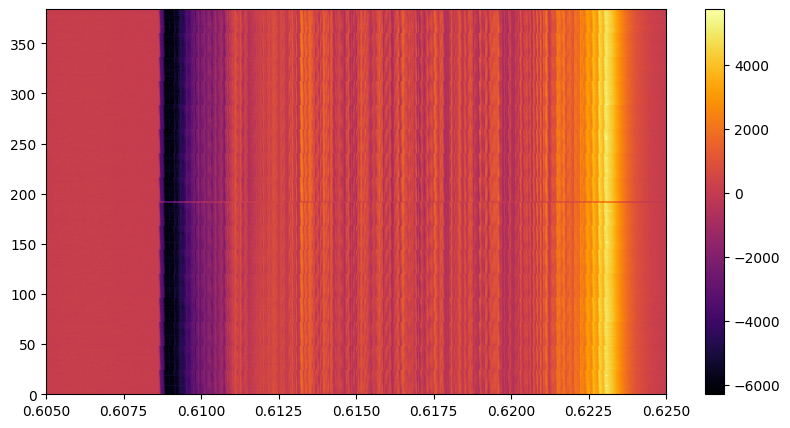

In [22]:
t2plot = [0.605, 0.625]
folderPath = '/media/jbhunt/EPHYS-01/2025-07-31_11-36-27/Record Node 101'
datPath = '/media/jbhunt/EPHYS-01/2025-07-31_11-36-27/rampupdownzerosartifact.dat'
fig, ax = op.plotRawNeuropixelsData(t2plot, folderPath, datPath, vmin=None, vmax=None)

In [4]:
clusterList, pList = op.defineOptoPopulationTTest(h5file, clusterFile, optoTimes)
optoUnitsT = list()
for i, p in enumerate(pList):
    if p < 0.01:
        optoUnitsT.append(clusterList[i])
optoUnitsManual = [99, 146, 150, 173, 181, 222, 290, 382]
optoUnitsZeta = defineOptoPopulation(h5file, clusterFile)

Text(0, 0.5, 'FR (spikes/sec)')

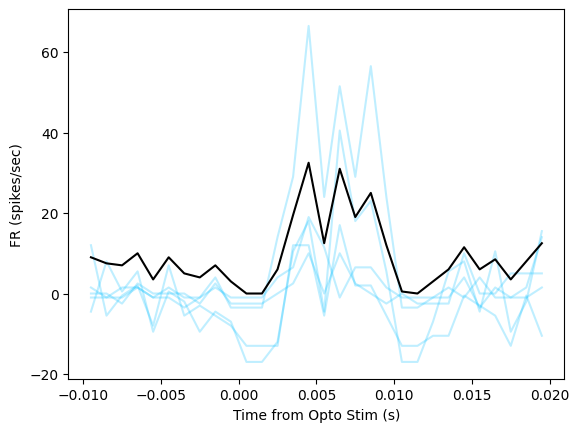

In [32]:
%matplotlib inline
import matplotlib.pyplot as plt
fig, ax = plt.subplots()
frList = list()
session = AnalysisObject(h5file)
population = session._population()
for unit in population:
    if unit.cluster in optoUnitsManual:
        spikeTimes = unit.timestamps
        t, fr = unit.peth(optoTimes, (-0.01, 0.02), 0.001)
        baseline = np.mean(fr[0:5])
        corrected = fr - baseline
        #plt.plot(t, corrected, color='magenta', alpha=0.25)
        #frList.append(fr)
    if unit.cluster in optoUnitsZeta:
        spikeTimes = unit.timestamps
        t, fr = unit.peth(optoTimes, (-0.01, 0.02), 0.001)
        baseline = np.mean(fr[0:5])
        corrected = fr - baseline
        #plt.plot(t, corrected, color='limegreen', alpha=0.25)
       # frList.append(fr)
    if unit.cluster in optoUnitsFinal:
        spikeTimes = unit.timestamps
        t, fr = unit.peth(optoTimes, (-0.01, 0.02), 0.001)
        baseline = np.mean(fr[0:5])
        corrected = fr - baseline
        plt.plot(t, corrected, color='deepskyblue', alpha=0.25)
        frList.append(fr)
frAvg = np.mean(frList, axis=0)
plt.plot(t, frAvg, color='k')
#plt.ylim(-50, 50)
plt.xlabel('Time from Opto Stim (s)')
plt.ylabel('FR (spikes/sec)')

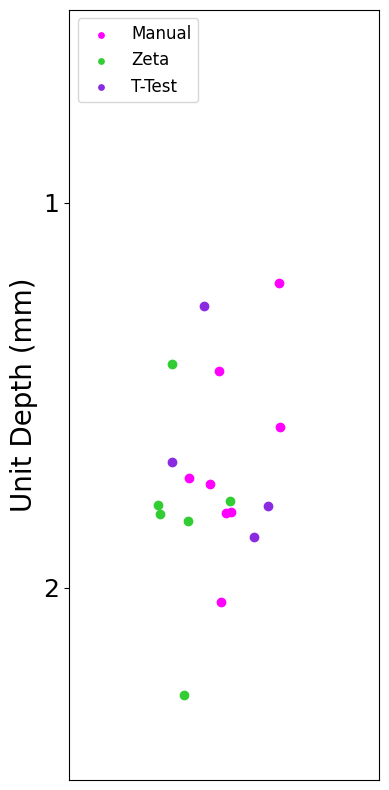

In [12]:
depthDict = pop.getUnitDepth(h5file, optoUnitsManual, optoUnitsZeta, optoUnitsT, depthDict=None)
fig, ax = pl.plotUnitDepth(depthDict, saveFig=False)
ax.scatter(0, 0, s=15, color='magenta', label='Manual')
ax.scatter(0, 0, s=15, color='limegreen', label='Zeta')
ax.scatter(0, 0, s=15, color='blueviolet', label='T-Test')
ax.set_ylim(250, 50)
ax.legend(fontsize=12, loc='upper left')

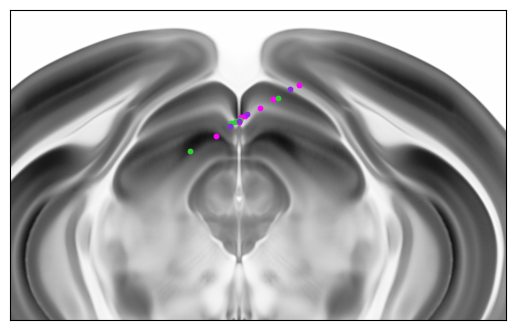

In [22]:
coordDict = pop.getUnitCoords(h5file, optoUnitsManual, optoUnitsZeta, optoUnitsT)
fig, ax = pl.plotUnitDepthOverBrain(coordDict)

In [27]:
optoUnits2 = list()
for unit in optoUnitsManual:
    if unit in optoUnitsZeta:
        optoUnits2.append(unit)
    if unit in optoUnitsT:
        optoUnits2.append(unit)
for unit in optoUnitsZeta:
    if unit in optoUnitsManual:
        optoUnits2.append(unit)
    if unit in optoUnitsT:
        optoUnits2.append(unit)
for unit in optoUnitsT:
    if unit in optoUnitsZeta:
        optoUnits2.append(unit)
    if unit in optoUnitsManual:
        optoUnits2.append(unit)
optoUnitsFinal = np.unique(optoUnits2)
print(optoUnitsFinal)

[ 99 146 173 181 382]


In [77]:
factory = SessionFactory(tag='Suguru')
#sessions = factory.produce(experiment=('NPDreadd'), animals=('dreadd4.2'))
sessions = factory.produce(experiment=('Muscimol'), animals=('dreadd1', 'dreadd2', 'dreadd3', 'dreadd4'))

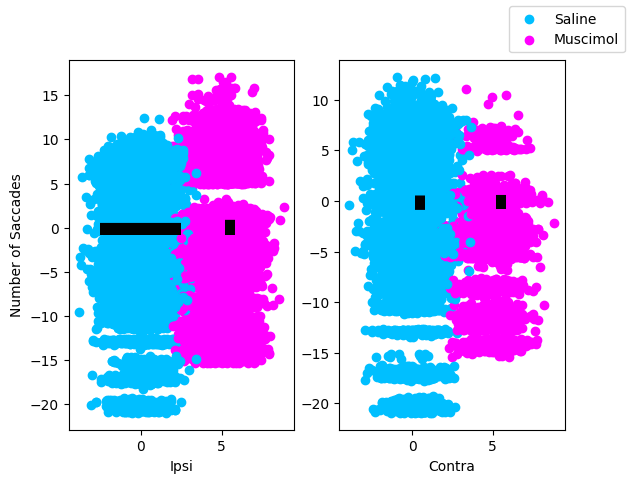

In [95]:
ipsiSal = list()
contraSal = list()
ipsiMus = list()
contraMus = list()
fig, ax = plt.subplots(1,2)
for session in sessions:
    h5file = os.path.join(session.home, 'output.hdf')
    labels = session.load('saccades/predicted/left/labels')
    #saccadesIpsi = len(np.where(labels == 1)[0])
    #saccadesContra = len(np.where(labels == -1)[0])
    saccadesIpsi = fs.calculateSaccadeStartPoint(h5file, session.saccadeTimestamps[labels==1, 0])
    saccadesContra = fs.calculateSaccadeStartPoint(h5file, session.saccadeTimestamps[labels==-1, 0])    
    if session.treatment == 'saline':
        ax[1].scatter(0 + np.random.randn(len(saccadesContra)), saccadesContra, color='deepskyblue', alpha=1)
        ax[0].scatter(0 + np.random.randn(len(saccadesIpsi)), saccadesIpsi, color='deepskyblue', alpha=1)
        ipsiSal.append(saccadesIpsi)
        contraSal.append(saccadesContra)
    elif session.treatment == 'muscimol':
        ax[1].scatter(5 + np.random.randn(len(saccadesContra)), saccadesContra, color='magenta', alpha=1)
        ax[0].scatter(5 + np.random.randn(len(saccadesIpsi)), saccadesIpsi, color='magenta', alpha=1)
        ipsiMus.append(saccadesIpsi)
        contraMus.append(saccadesContra)
avgIS = np.nanmean(ipsiSal)
avgCS = np.nanmean(contraSal)
avgIM = np.nanmean(ipsiMus)
avgCM = np.nanmean(contraMus)
ax[0].scatter(0, 0, color='deepskyblue', label='Saline')
ax[0].scatter(0, 0, color='magenta', label='Muscimol')
ax[0].hlines(avgIS, -2.5, 2.5, color='k')
ax[0].hlines(avgIM, 5.2, 5.8, color='k')
ax[1].hlines(avgCS, 0.2, 0.8, color='k')
ax[1].hlines(avgCM, 5.2, 5.8, color='k')
ax[0].set_xlabel('Ipsi')
ax[1].set_xlabel('Contra')
ax[0].set_ylabel('Number of Saccades')
#ax[0].set_xticks([])
#ax[1].set_xticks([])
#ax[0].set_ylim(0, 1000)
#ax[1].set_ylim(0, 1000)
fig.legend()

In [93]:
#plot animal by animal or maybe lines for averages per animal
print(len(ampList))
print(z.shape)
print(len(premotorUnits))

2390
(16, 2390)
16


Event 85 is NaN
Event 90 is NaN
Event 92 is NaN
Event 388 is NaN
Event 477 is NaN
Event 535 is NaN
Event 606 is NaN
Event 613 is NaN
Event 826 is NaN
Event 856 is NaN
Event 934 is NaN
Event 1317 is NaN
Event 1439 is NaN


/tmp/ipykernel_590608/2901413780.py:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(1, 3, figsize=(21, 7))


Event 46 is NaN
Event 270 is NaN
Event 778 is NaN
Event 987 is NaN
Event 1405 is NaN
Event 0 is NaN
Event 4 is NaN
Event 7 is NaN
Event 14 is NaN
Event 23 is NaN
Event 28 is NaN
Event 33 is NaN
Event 68 is NaN
Event 78 is NaN
Event 82 is NaN
Event 84 is NaN
Event 93 is NaN
Event 94 is NaN
Event 97 is NaN
Event 187 is NaN
Event 190 is NaN
Event 191 is NaN
Event 192 is NaN
Event 214 is NaN
Event 238 is NaN
Event 241 is NaN
Event 249 is NaN
Event 267 is NaN
Event 287 is NaN
Event 288 is NaN
Event 307 is NaN
Event 310 is NaN
Event 311 is NaN
Event 313 is NaN
Event 324 is NaN
Event 326 is NaN
Event 338 is NaN
Event 365 is NaN
Event 370 is NaN
Event 386 is NaN
Event 387 is NaN
Event 442 is NaN
Event 443 is NaN
Event 455 is NaN
Event 458 is NaN
Event 93 is NaN
Event 618 is NaN
Event 1087 is NaN
Event 1618 is NaN
Event 1624 is NaN
Event 1816 is NaN
Event 2183 is NaN


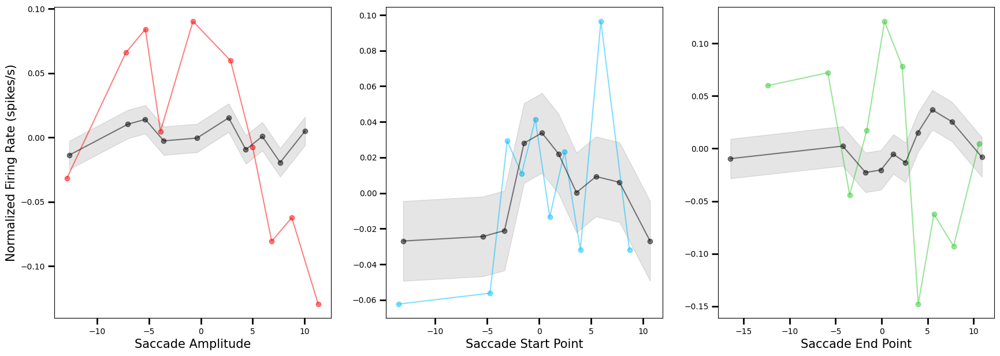

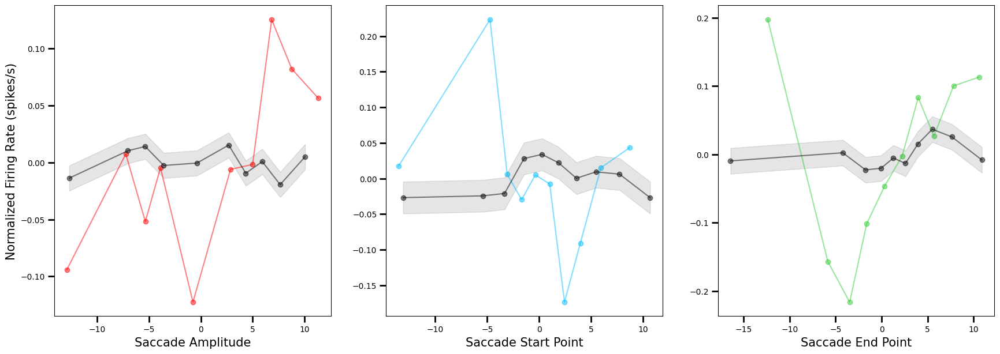

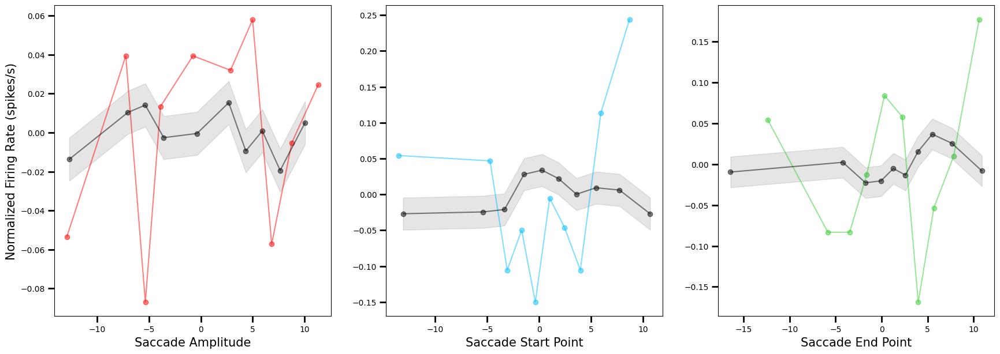

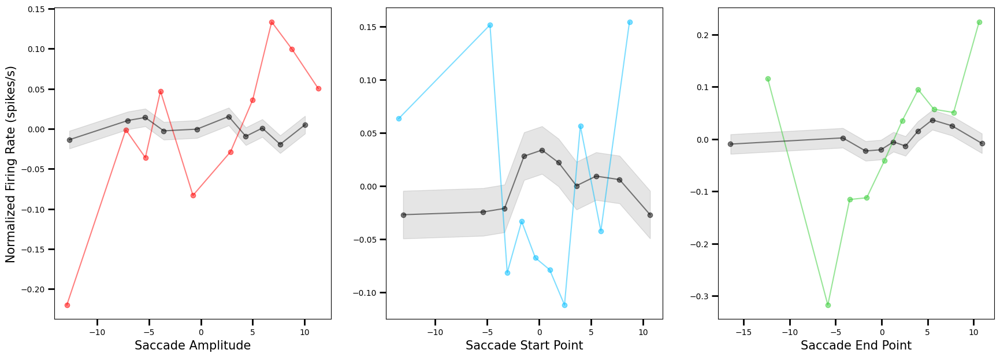

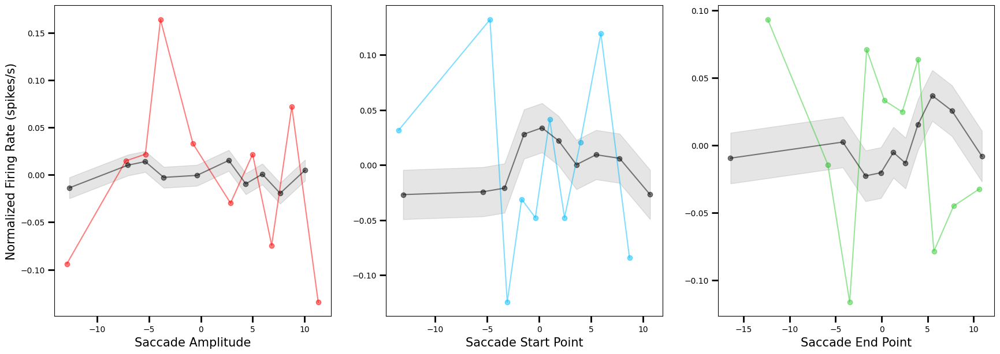

...

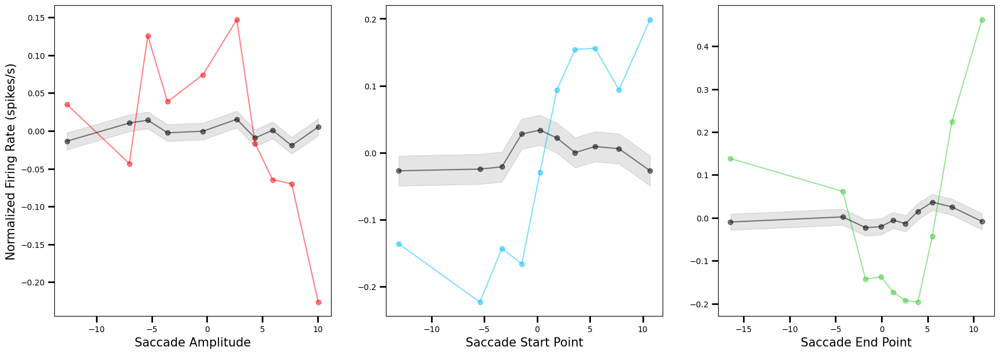

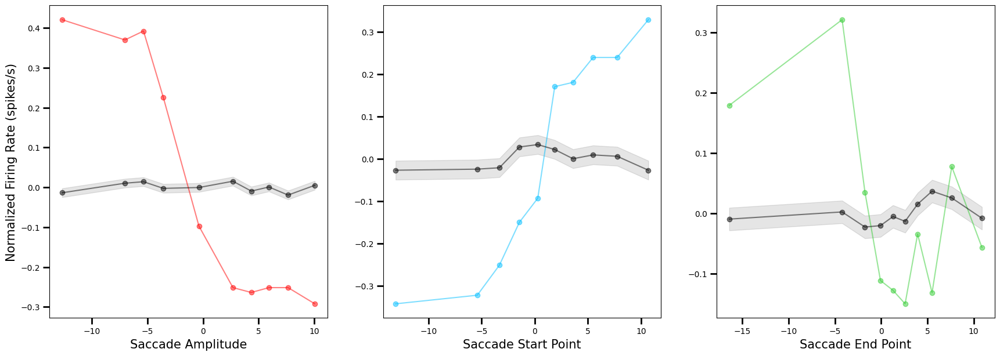

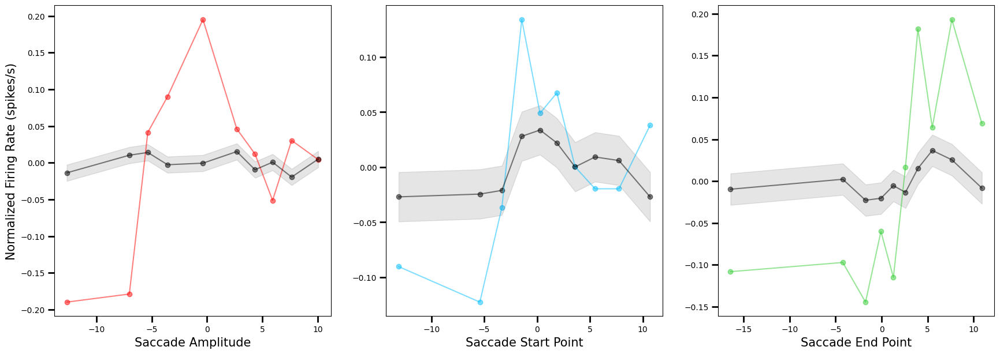

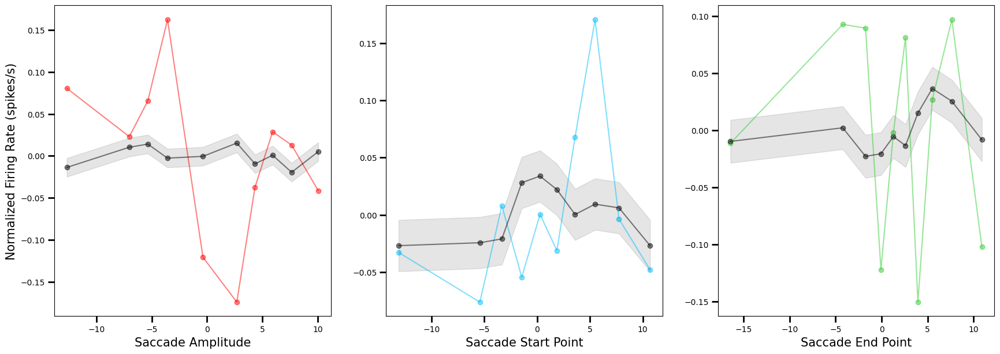

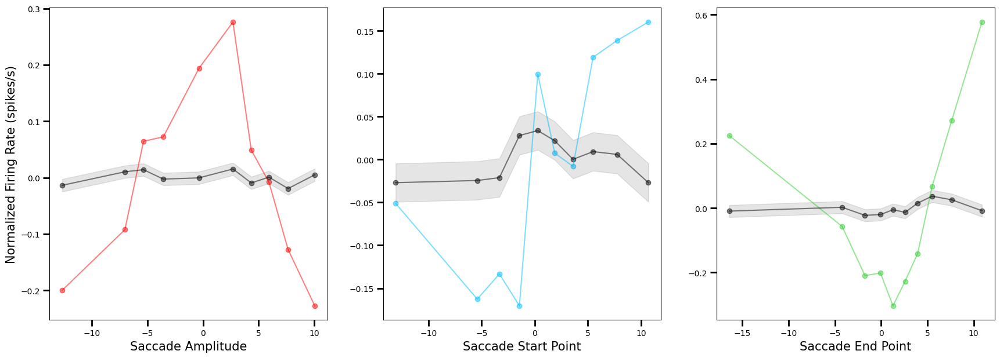

In [197]:
import os
import random
import matplotlib.pyplot as plt
from toolkit.saccades import binFiringRatesbyMetric
from toolkit.saccades import calculateSaccadeAmplitudes, calculateSaccadeStartPoint, calculateSaccadeEndPoint, computeNormalizedFiringRate
for base in fileList:
    h5file = os.path.join(base, 'output.hdf')
    session = AnalysisObject(h5file)
    clusterFile = os.path.join(base,'ephys/sorting/manual/spike_clusters.npy')
    premotorUnits = pop.definePremotorPopulation(h5file, clusterFile)
    driven, spontaneous = fs.parseSaccadeType(h5file)
    labels = session.load('saccades/predicted/left/labels')
    ampList = calculateSaccadeAmplitudes(h5file, driven)
    startList = calculateSaccadeStartPoint(h5file, driven)
    endList = calculateSaccadeEndPoint(h5file, driven)
    z = computeNormalizedFiringRate(h5file, premotorUnits, driven, [-0.3, 0])
    for idk, unit in enumerate(premotorUnits):
        ampShuffled = random.sample(ampList, len(ampList))
        startShuffled = random.sample(startList, len(startList))
        endShuffled = random.sample(endList, len(endList))
        fig, ax = plt.subplots(1, 3, figsize=(21, 7))
        ampAvg, startAvg, endAvg, binStartA, binStartS, binStartE = binFiringRatesbyMetric(z, ampList, startList, endList, idk, 10)
        binMidA, binMidS, binMidE = computeBinMiddles(binStartA, binStartS, binStartE) 
        ampAvgS, startAvgS, endAvgS, binStartAS, binStartSS, binStartES = binFiringRatesbyMetric(z, ampShuffled, startShuffled, endShuffled, idk, 10)
        binMidAS, binMidSS, binMidES = computeBinMiddles(binStartAS, binStartSS, binStartES)   
        ax[0].plot(binMidA, ampAvg, color='r', alpha=0.5)
        ax[1].plot(binMidS, startAvg, color='deepskyblue', alpha=0.5)
        ax[2].plot(binMidE, endAvg, color='limegreen', alpha=0.5)
        ax[0].scatter(binMidA, ampAvg, color='r', alpha=0.5)
        ax[1].scatter(binMidS, startAvg, color='deepskyblue', alpha=0.5)
        ax[2].scatter(binMidE, endAvg, color='limegreen', alpha=0.5)
        ax[0].plot(shuffAmpBin, shuffAmpFR, color='k', alpha=0.5)
        ax[1].plot(shuffStartBin, shuffStartFR, color='k', alpha=0.5)
        ax[2].plot(shuffEndBin, shuffEndFR, color='k', alpha=0.5)
        ax[0].scatter(shuffAmpBin, shuffAmpFR, color='k', alpha=0.5)
        ax[1].scatter(shuffStartBin, shuffStartFR, color='k', alpha=0.5)
        ax[2].scatter(shuffEndBin, shuffEndFR, color='k', alpha=0.5)
        ax[0].fill_between(shuffAmpBin, shuffAmpFR - shuffAmpFRS, shuffAmpFR + shuffAmpFRS, color='k', alpha=0.1)
        ax[1].fill_between(shuffStartBin, shuffStartFR - shuffStartFRS, shuffStartFR + shuffStartFRS, color='k', alpha=0.1)
        ax[2].fill_between(shuffEndBin, shuffEndFR - shuffEndFRS, shuffEndFR + shuffEndFRS, color='k', alpha=0.1)
        #ax[0].plot(binMidAS, ampAvgS, color='k', alpha=0.5)
        #ax[1].plot(binMidSS, startAvgS, color='k', alpha=0.5)
       # ax[2].plot(binMidES, endAvgS, color='k', alpha=0.5)
       # ax[0].scatter(binMidAS, ampAvgS, color='k', alpha=0.5)
       # ax[1].scatter(binMidSS, startAvgS, color='k', alpha=0.5)
       # ax[2].scatter(binMidES, endAvgS, color='k', alpha=0.5)
        #ax[0].scatter(ampList, z[idk, :], color='r', alpha=0.05)
        #ax[1].scatter(startList, z[idk, :], color='deepskyblue', alpha=0.05)
        #ax[2].scatter(endList, z[idk, :], color='limegreen', alpha=0.05)
        #scat = ax.scatter(startList, endList, c=z[idk, :], alpha=0.75, s=4, vmin=-1, vmax=1.5)
        ax[0].set_xlabel('Saccade Amplitude', fontsize=15)
        ax[1].set_xlabel('Saccade Start Point', fontsize=15)
        ax[2].set_xlabel('Saccade End Point', fontsize=15)
        ax[0].set_ylabel('Normalized Firing Rate (spikes/s)', fontsize=15)
        ax[0].tick_params(axis='both', which='major', length=8, width=2)
        ax[1].tick_params(axis='both', which='major', length=8, width=2)
        ax[2].tick_params(axis='both', which='major', length=8, width=2)

Event 85 is NaN
Event 90 is NaN
Event 92 is NaN
Event 388 is NaN
Event 477 is NaN
Event 535 is NaN
Event 606 is NaN
Event 613 is NaN
Event 826 is NaN
Event 856 is NaN
Event 934 is NaN
Event 1317 is NaN
Event 1439 is NaN
Event 46 is NaN
Event 270 is NaN
Event 778 is NaN
Event 987 is NaN
Event 1405 is NaN
Event 0 is NaN
Event 4 is NaN
Event 7 is NaN
Event 14 is NaN
Event 23 is NaN
Event 28 is NaN
Event 33 is NaN
Event 68 is NaN
Event 78 is NaN
Event 82 is NaN
Event 84 is NaN
Event 93 is NaN
Event 94 is NaN
Event 97 is NaN
Event 187 is NaN
Event 190 is NaN
Event 191 is NaN
Event 192 is NaN
Event 214 is NaN
Event 238 is NaN
Event 241 is NaN
Event 249 is NaN
Event 267 is NaN
Event 287 is NaN
Event 288 is NaN
Event 307 is NaN
Event 310 is NaN
Event 311 is NaN
Event 313 is NaN
Event 324 is NaN
Event 326 is NaN
Event 338 is NaN
Event 365 is NaN
Event 370 is NaN
Event 386 is NaN
Event 387 is NaN
Event 442 is NaN
Event 443 is NaN
Event 455 is NaN
Event 458 is NaN
Event 93 is NaN
Event 618 is NaN

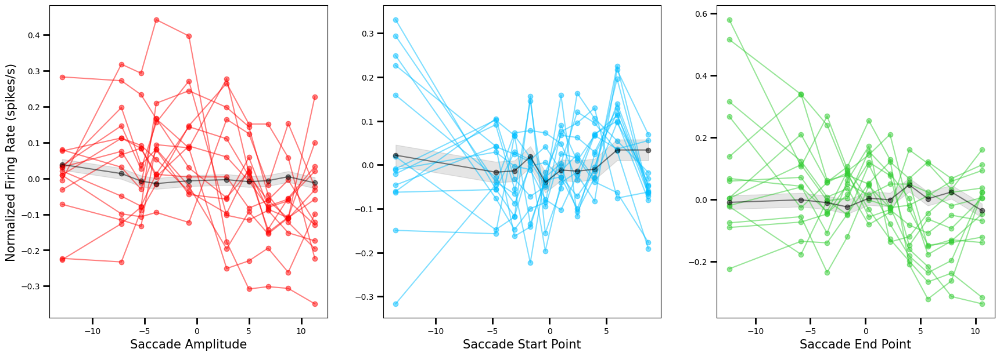

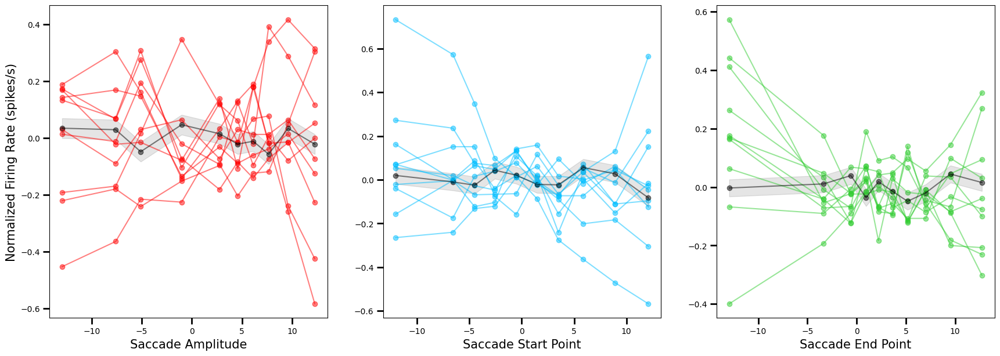

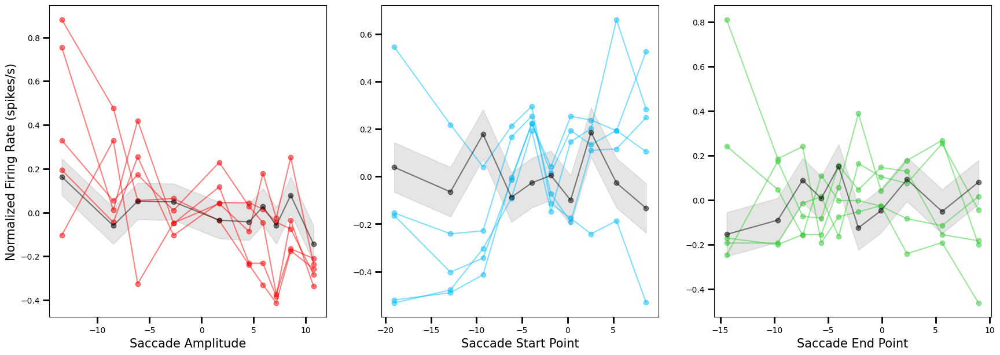

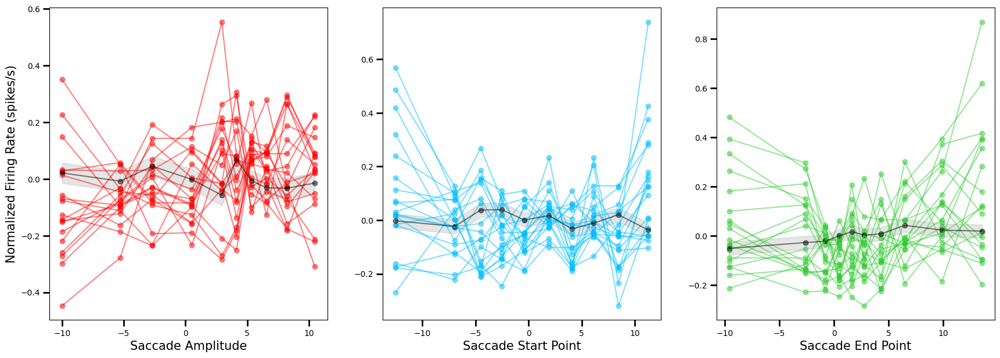

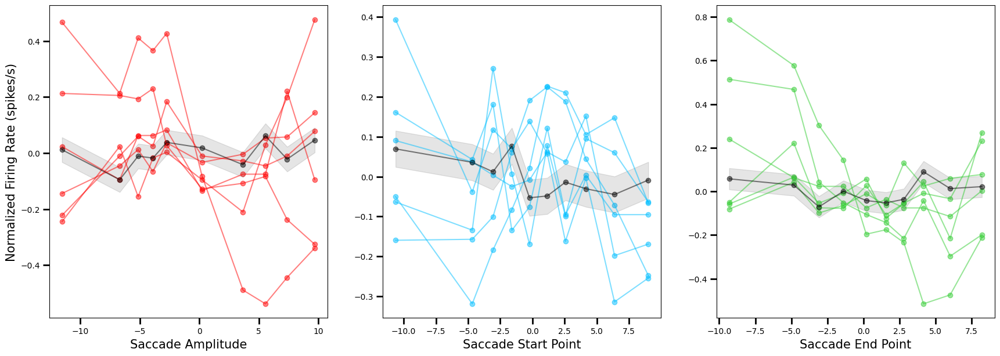

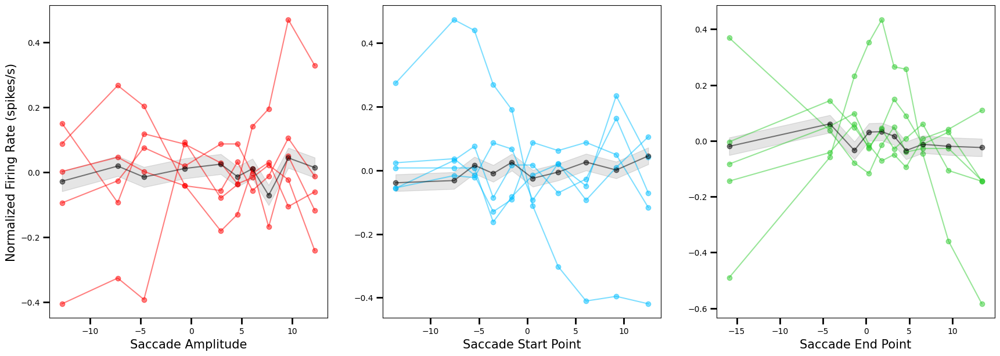

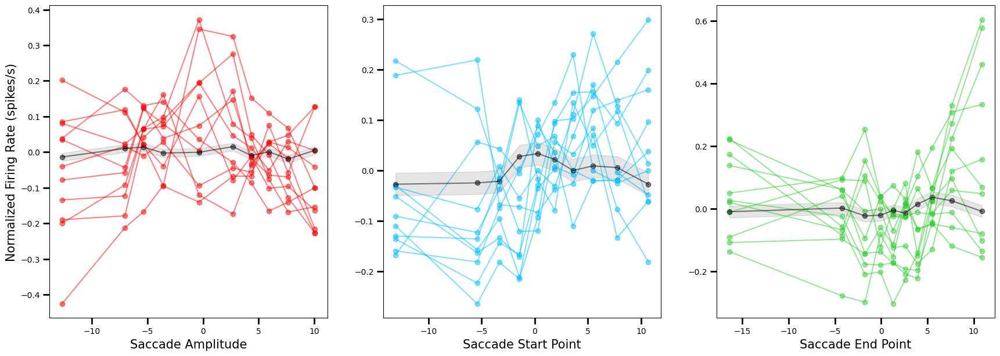

In [196]:
import os
import matplotlib.pyplot as plt
from toolkit.saccades import binFiringRatesbyMetric
from toolkit.saccades import calculateSaccadeAmplitudes, calculateSaccadeStartPoint, calculateSaccadeEndPoint, computeNormalizedFiringRate, computeBinMiddles
for base in fileList:
    fig, ax = plt.subplots(1, 3, figsize=(21, 7))
    h5file = os.path.join(base, 'output.hdf')
    session = AnalysisObject(h5file)
    clusterFile = os.path.join(base,'ephys/sorting/manual/spike_clusters.npy')
    premotorUnits = pop.definePremotorPopulationExclusive(h5file, clusterFile)
    driven, spontaneous = fs.parseSaccadeType(h5file)
    labels = session.load('saccades/predicted/left/labels')
    ampList = calculateSaccadeAmplitudes(h5file, driven)
    startList = calculateSaccadeStartPoint(h5file, driven)
    endList = calculateSaccadeEndPoint(h5file, driven)
    ampShuffled = random.sample(ampList, len(ampList))
    startShuffled = random.sample(startList, len(startList))
    endShuffled = random.sample(endList, len(endList))
    shuffAmpFR = list()
    shuffStartFR = list()
    shuffEndFR = list()
    shuffAmpBin = list()
    shuffStartBin = list()
    shuffEndBin = list()
    z = computeNormalizedFiringRate(h5file, premotorUnits, driven, [-0.3, 0])
    for idk, unit in enumerate(premotorUnits):
        ampAvgS, startAvgS, endAvgS, binStartAS, binStartSS, binStartES = binFiringRatesbyMetric(z, ampShuffled, startShuffled, endShuffled, idk, 10)
        binMidAS, binMidSS, binMidES = computeBinMiddles(binStartAS, binStartSS, binStartES)
        shuffAmpFR.append(ampAvgS)
        shuffStartFR.append(startAvgS)
        shuffEndFR.append(endAvgS)
        shuffAmpBin.append(binMidAS)
        shuffStartBin.append(binMidSS)
        shuffEndBin.append(binMidES)
        ampAvg, startAvg, endAvg, binStartA, binStartS, binStartE = binFiringRatesbyMetric(z, ampList, startList, endList, idk, 10)
        binMidA, binMidS, binMidE = computeBinMiddles(binStartA, binStartS, binStartE)
        ax[0].plot(binMidA, ampAvg, color='r', alpha=0.5)
        ax[1].plot(binMidS, startAvg, color='deepskyblue', alpha=0.5)
        ax[2].plot(binMidE, endAvg, color='limegreen', alpha=0.5)
        ax[0].scatter(binMidA, ampAvg, color='r', alpha=0.5)
        ax[1].scatter(binMidS, startAvg, color='deepskyblue', alpha=0.5)
        ax[2].scatter(binMidE, endAvg, color='limegreen', alpha=0.5)
        #scat = ax.scatter(startList, endList, c=z[idk, :], alpha=0.75, s=4, vmin=-1, vmax=1.5)
    shuffAmpFR = np.mean(shuffAmpFR, axis=0)
    shuffStartFR = np.mean(shuffStartFR, axis=0)
    shuffEndFR = np.mean(shuffEndFR, axis=0)
    shuffAmpBin = np.mean(shuffAmpBin, axis=0)
    shuffStartBin = np.mean(shuffStartBin, axis=0)
    shuffEndBin = np.mean(shuffEndBin, axis=0)
    shuffAmpFRS = np.std(shuffAmpFR)
    shuffStartFRS = np.std(shuffStartFR)
    shuffEndFRS = np.std(shuffEndFR)
    shuffAmpBinS = np.std(shuffAmpBin)
    shuffStartBinS = np.std(shuffStartBin)
    shuffEndBinS = np.std(shuffEndBin)
    ax[0].plot(shuffAmpBin, shuffAmpFR, color='k', alpha=0.5)
    ax[1].plot(shuffStartBin, shuffStartFR, color='k', alpha=0.5)
    ax[2].plot(shuffEndBin, shuffEndFR, color='k', alpha=0.5)
    ax[0].scatter(shuffAmpBin, shuffAmpFR, color='k', alpha=0.5)
    ax[1].scatter(shuffStartBin, shuffStartFR, color='k', alpha=0.5)
    ax[2].scatter(shuffEndBin, shuffEndFR, color='k', alpha=0.5)
    ax[0].fill_between(shuffAmpBin, shuffAmpFR - shuffAmpFRS, shuffAmpFR + shuffAmpFRS, color='k', alpha=0.1)
    ax[1].fill_between(shuffStartBin, shuffStartFR - shuffStartFRS, shuffStartFR + shuffStartFRS, color='k', alpha=0.1)
    ax[2].fill_between(shuffEndBin, shuffEndFR - shuffEndFRS, shuffEndFR + shuffEndFRS, color='k', alpha=0.1)
    ax[0].set_xlabel('Saccade Amplitude', fontsize=15)
    ax[1].set_xlabel('Saccade Start Point', fontsize=15)
    ax[2].set_xlabel('Saccade End Point', fontsize=15)
    ax[0].set_ylabel('Normalized Firing Rate (spikes/s)', fontsize=15)
    ax[0].tick_params(axis='both', which='major', length=8, width=2)
    ax[1].tick_params(axis='both', which='major', length=8, width=2)
    ax[2].tick_params(axis='both', which='major', length=8, width=2)

Event 85 is NaN
Event 90 is NaN
Event 92 is NaN
Event 388 is NaN
Event 477 is NaN
Event 535 is NaN
Event 606 is NaN
Event 613 is NaN
Event 826 is NaN
Event 856 is NaN
Event 934 is NaN
Event 1317 is NaN
Event 1439 is NaN
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936
936


/tmp/ipykernel_590608/1804052529.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(1, 3, figsize=(21, 7))


936
936
936
936
Event 46 is NaN
Event 270 is NaN
Event 778 is NaN
Event 987 is NaN
Event 1405 is NaN
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
827
Event 0 is NaN
Event 4 is NaN
Event 7 is NaN
Event 14 is NaN
Event 23 is NaN
Event 28 is NaN
Event 33 is NaN
Event 68 is NaN
Event 78 is NaN
Event 82 is NaN
Event 84 is NaN
Event 93 is NaN
Event 94 is NaN
Event 97 is NaN
Event 187 is NaN
Event 190 is NaN
Event 191 is NaN
Event 192 is NaN
Event 214 is NaN
Event 238 is NaN
Event 241 is NaN
Event 249 is NaN
Event 267 is NaN
Event 287 is NaN
Event 288 is NaN
Event 307 is NaN
Event 310 is NaN
Event 311 is NaN
Event 313 is NaN
Event 324 is NaN
Event 326 is NaN
Event 338 is NaN
Event 365 is NaN
Event 370 is NaN
Event 386 is NaN
Event 387 is NaN
Event 442 is NaN
Event 443 is NaN
Event 455 is NaN
Event 458 is NaN
212
212
212
212
212
212
212
212
212
212
212
212
212


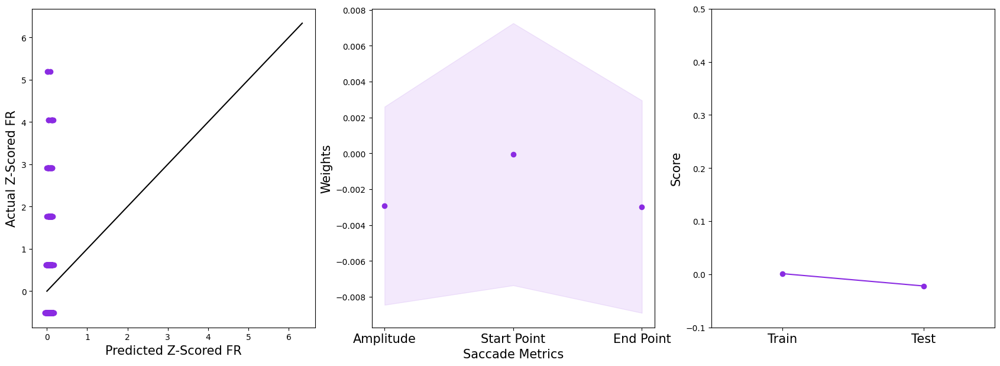

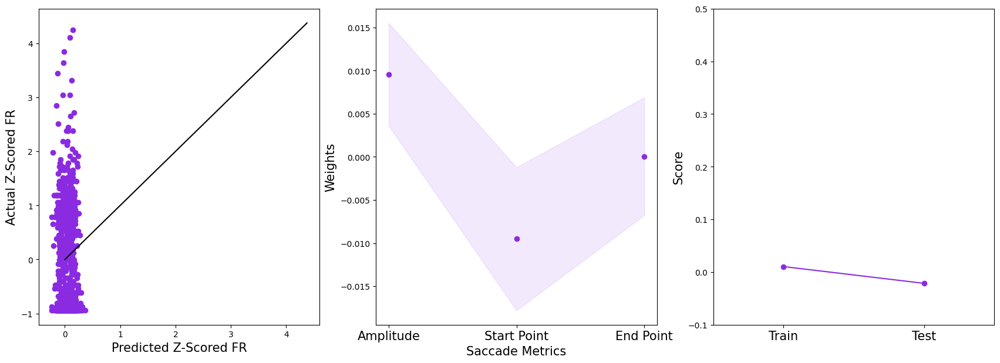

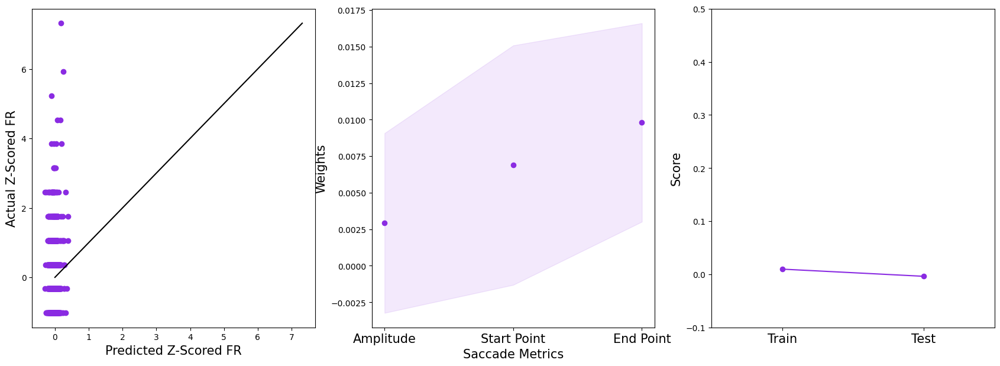

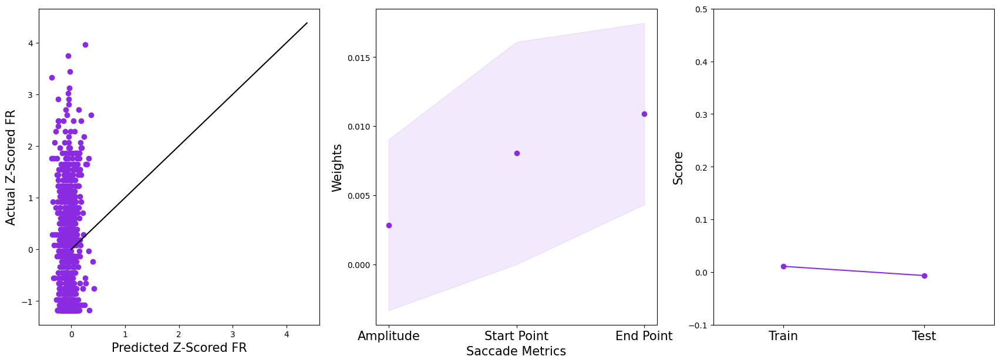

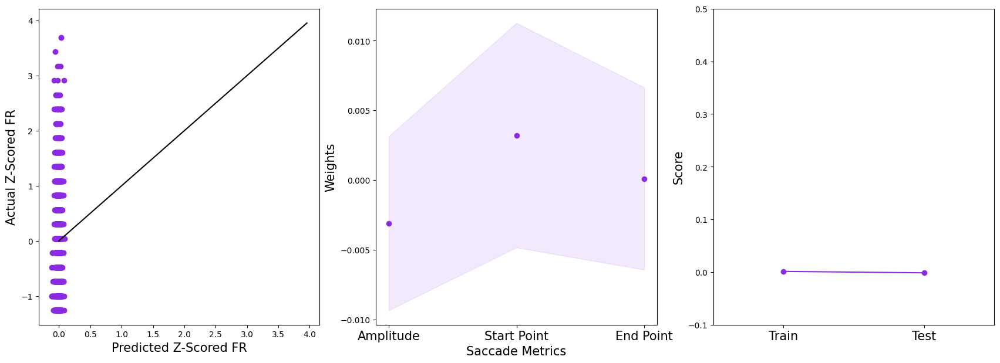

...

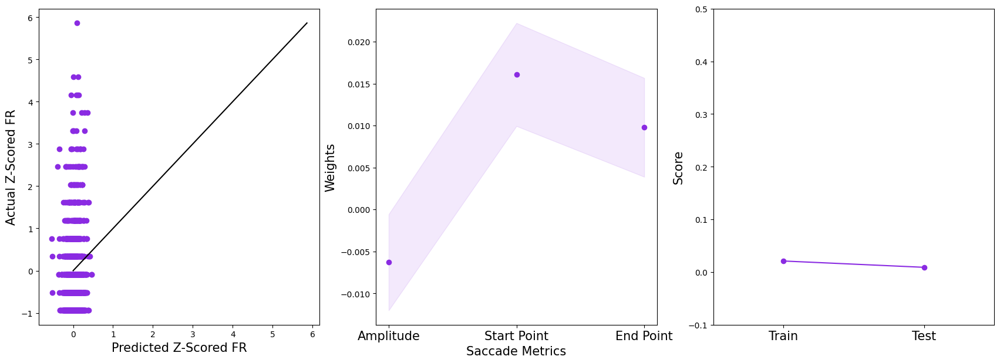

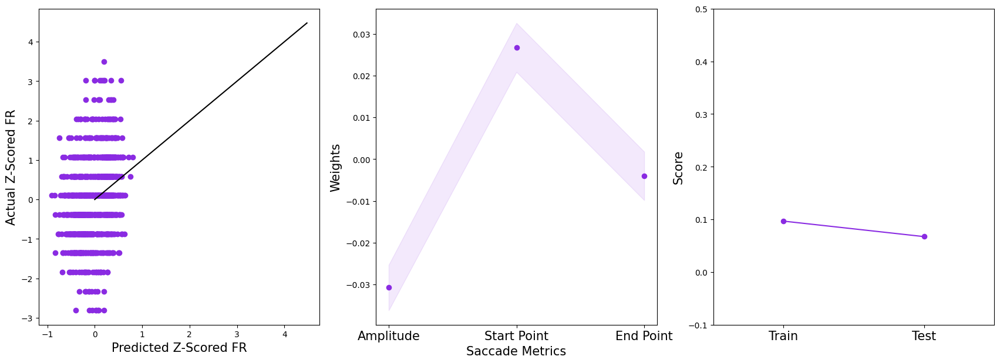

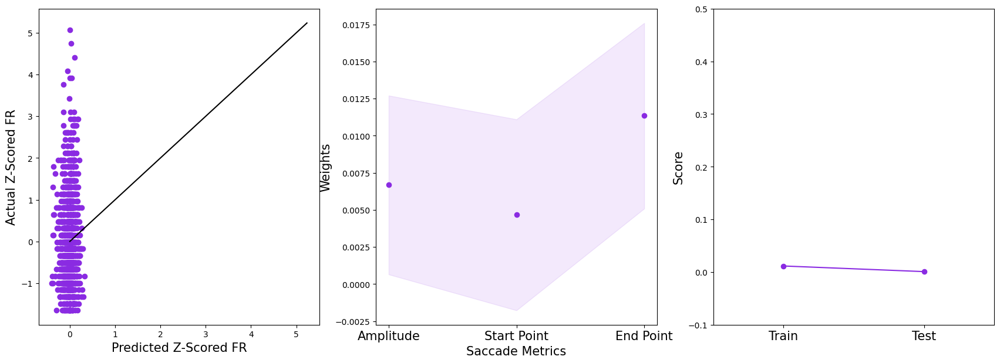

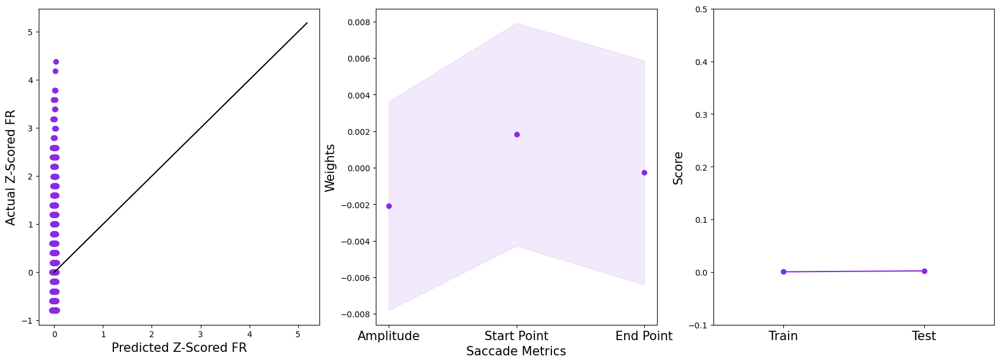

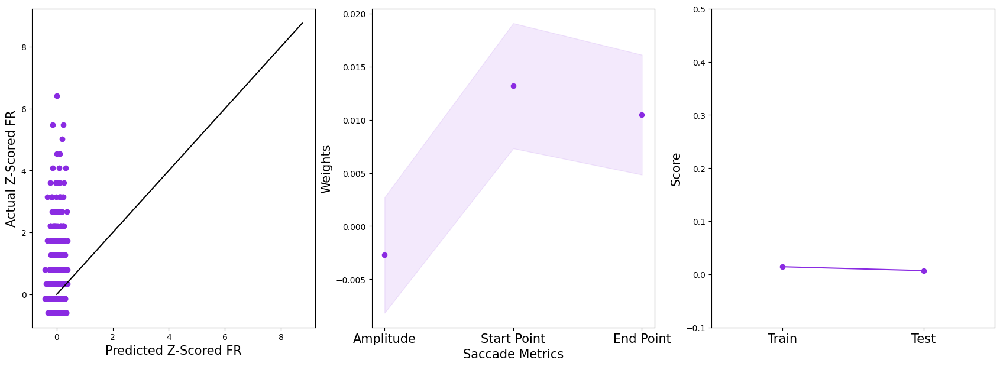

In [198]:
from toolkit.saccades import generateSaccadeMetricArray
from toolkit.prediction import predictSingleUnitActivity
for base in fileList:
    h5file = os.path.join(base, 'output.hdf')
    session = AnalysisObject(h5file)
    clusterFile = os.path.join(base,'ephys/sorting/manual/spike_clusters.npy')
    premotorUnits = pop.definePremotorPopulation(h5file, clusterFile)
    driven, spontaneous = fs.parseSaccadeType(h5file)
    labels = session.load('saccades/predicted/left/labels')
    ampList = calculateSaccadeAmplitudes(h5file, driven)
    startList = calculateSaccadeStartPoint(h5file, driven)
    endList = calculateSaccadeEndPoint(h5file, driven)
    sacMetrics = generateSaccadeMetricArray(h5file, ampList, startList, endList)
    trialsToAnalyze = range(0, len(sacMetrics[:, 0]))
    population = session._population()
    z = computeNormalizedFiringRate(h5file, premotorUnits, driven, [-0.3, 0])
    for unitActivity in z:
        fig, ax = plt.subplots(1, 3, figsize=(21, 7))
        predicted, weights, lowerCI, upperCI, scoreTrain, scoreTest, test_half = predictSingleUnitActivity(trialsToAnalyze, sacMetrics, unitActivity)
        ax[0].scatter(predicted, unitActivity[test_half], color = 'blueviolet')
        ax[0].set_xlabel('Predicted Z-Scored FR', fontsize=15)
        ax[0].set_ylabel('Actual Z-Scored FR', fontsize=15)
        maxPredict = np.max(predicted)
        maxActual = np.max(unitActivity)
        if maxPredict > maxActual:
            ax[0].plot((0, maxPredict), (0, maxPredict), color = 'k')
        else:
            ax[0].plot((0, maxActual), (0, maxActual), color = 'k')    
        ax[1].scatter([0, 1, 2], weights, color='blueviolet', s=35)
        ax[1].fill_between([0, 1, 2], lowerCI, upperCI, color='blueviolet', alpha=0.1)
        ax[1].set_xlabel('Saccade Metrics', fontsize=15)
        ax[1].set_ylabel('Weights', fontsize=15)
        ax[1].set_xticks([0, 1, 2])
        ax[1].set_xticklabels(['Amplitude', 'Start Point', 'End Point'], fontsize=15)
        ax[2].scatter([0, 1], [scoreTrain, scoreTest], color='blueviolet', s=35)
        ax[2].plot([0, 1], [scoreTrain, scoreTest], color='blueviolet')
        ax[2].set_xticks([0, 1])
        ax[2].set_xticklabels(['Train', 'Test'], fontsize=15)
        ax[2].set_ylabel('Score', fontsize=15)
        ax[2].set_ylim(-0.1, 0.5)
        ax[2].set_xlim(-0.5, 1.5)

In [180]:
print(weights)

[0.00479496 0.00700015 0.01179511]


In [151]:
print(len(ampList))
print(len(startList))
print(len(endList))


1347
1347
1035
